# Modifying VAE architecture
Using original naive VAE model, you will get poor images.  
  
![](output.png) 　　 ![](stl10raw.png)  

[VAE output], [STL10 images]

To get better performance, you should modify VAE model architectures.  
It's up to you!!  
You should get better images than me ^_^   

Understand the VAE architecture and dimensions of mu and variance.  
You can change each layer's dimension also.  

Input dimension of STL10 dataset is 3 x 96 x 96.  
The output dimension of VAE should be 3 x 96 x 96 as the same as the input.


In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torchvision import datasets, transforms
from torch.autograd import Variable
from torchvision.utils import save_image

In [29]:
bs = 512
# MNIST Dataset
train_dataset = datasets.STL10(root='data', split='train', download=True, transform=transforms.ToTensor())
val_dataset = datasets.STL10(root='data', split='test', download=True, transform=transforms.ToTensor())

# Data Loader (Input Pipeline)
train_loader = torch.utils.data.DataLoader(dataset=train_dataset, batch_size=bs, shuffle=True)
test_loader = torch.utils.data.DataLoader(dataset=val_dataset, batch_size=bs, shuffle=False)

# train data
print(train_dataset[0][0].size())

Files already downloaded and verified
Files already downloaded and verified
torch.Size([3, 96, 96])


In [30]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

## VAE Model
![](https://velog.velcdn.com/images/onground/post/0aa95c10-f56f-43b0-bd22-46f302a4c92f/image.png)

In [31]:
class VAE(nn.Module):
    def __init__(self, x_dim, h_dim, z_dim):
        super(VAE, self).__init__()

        ###########################################
        # TODO: Modify the encoder and decoder
        # to have better performance
        # E.g. add more layers, change the activation function,
        # change the number of hidden units, use cnn, etc.
        #
        # Encoder
        self.fc1 = nn.Linear(x_dim, h_dim)
        self.fc2_mu = nn.Linear(h_dim, z_dim)
        self.fc2_logvar = nn.Linear(h_dim, z_dim)

        # Decoder
        self.fc3 = nn.Linear(z_dim, h_dim)
        self.fc4 = nn.Linear(h_dim, x_dim)
        ###########################################

    def encoder(self, x):
        h = F.relu(self.fc1(x))
        return self.fc2_mu(h), self.fc2_logvar(h)

    def sampling(self, mu, logvar):
        std = torch.exp(0.5 * logvar)
        eps = torch.randn_like(std)
        return eps.mul(std).add_(mu) # return z sample

    def decoder(self, z):
        h = F.relu(self.fc3(z))
        return F.sigmoid(self.fc4(h))

    def forward(self, x):
        # If you are using cnn, yon don't need to flatten the image (just use x as input for encoder)
        mu, logvar = self.encoder(x.view(-1, 3*96*96))
        z = self.sampling(mu, logvar)
        return self.decoder(z), mu, logvar

In [32]:
vae = VAE(x_dim=3*96*96, h_dim=400, z_dim=20).to(device)
print(vae)

VAE(
  (fc1): Linear(in_features=27648, out_features=400, bias=True)
  (fc2_mu): Linear(in_features=400, out_features=20, bias=True)
  (fc2_logvar): Linear(in_features=400, out_features=20, bias=True)
  (fc3): Linear(in_features=20, out_features=400, bias=True)
  (fc4): Linear(in_features=400, out_features=27648, bias=True)
)


In [33]:
optimizer = optim.Adam(vae.parameters(), lr=0.001)

# reconstruction error + KL divergence losses
def loss_function(recon_x, x, mu, logvar):
    BCE = F.binary_cross_entropy(recon_x, x.view(-1, 3*96*96), reduction='sum')
    KLD = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())
    return BCE + KLD

## Training

In [34]:
from tqdm.notebook import tqdm

In [35]:
def train(epoch):
    vae.train()
    train_loss = 0
    # progress = tqdm(enumerate(train_loader))
    for batch_idx, (data, _) in enumerate(train_loader):
        data = data.to(device)
        optimizer.zero_grad()

        recon_batch, mu, logvar = vae(data)
        loss = loss_function(recon_batch, data, mu, logvar)

        loss.backward()
        train_loss += loss.item()
        optimizer.step()

        # progress.set_description(f"Epoch: {epoch} Loss: {loss.item() / len(data)}")
    
    print('====> Epoch: {} Average loss: {:.4f}'.format(
        epoch, train_loss / len(train_loader)))

In [36]:
def test():
    vae.eval()
    test_loss = 0

    with torch.no_grad():
        for data, _ in test_loader:
            data = data.to(device)
            recon_batch, mu, logvar = vae(data)

            test_loss += loss_function(recon_batch, data, mu, logvar).item()

    test_loss /= len(test_loader)
    print('====> Test set loss: {:.4f}'.format(test_loss))

In [37]:
for epoch in range(1, 51):
    train(epoch)
    test()

====> Epoch: 1 Average loss: 10366236.3000
====> Test set loss: 9706104.2812
====> Epoch: 2 Average loss: 9605476.8000
====> Test set loss: 9555186.5000
====> Epoch: 3 Average loss: 9472630.5500
====> Test set loss: 9366364.6875
====> Epoch: 4 Average loss: 9298932.2000
====> Test set loss: 9207730.6562
====> Epoch: 5 Average loss: 9169073.3500
====> Test set loss: 9130411.5312
====> Epoch: 6 Average loss: 9084715.0500
====> Test set loss: 9052236.6562
====> Epoch: 7 Average loss: 9024496.3000
====> Test set loss: 8987118.8438
====> Epoch: 8 Average loss: 8945645.4500
====> Test set loss: 8901413.0625
====> Epoch: 9 Average loss: 8873130.2000
====> Test set loss: 8851056.7812
====> Epoch: 10 Average loss: 8842490.9000
====> Test set loss: 8902134.3125
====> Epoch: 11 Average loss: 8823155.0500
====> Test set loss: 8787238.5625
====> Epoch: 12 Average loss: 8739876.1500
====> Test set loss: 8732322.4688
====> Epoch: 13 Average loss: 8675550.6000
====> Test set loss: 8676082.6875
====> E

In [38]:
torch.save(vae.state_dict(), 'vae.pth')

## Inference

In [18]:
!pwd

/home/hjs/PycharmProjects/pyTorch/VAE


In [39]:
with torch.no_grad():
    z = torch.randn(1, 20).cuda()
    sample = vae.decoder(z).cuda()
    print(sample.shape)

    save_image(sample.view(1, 3, 96, 96), 'sample_' + '.png')

torch.Size([1, 27648])


In [40]:
epochs = 30
vae = VAE(x_dim=3*96*96, h_dim=400, z_dim=20).to(device)
vae.load_state_dict(torch.load('vae.pth'))

for epoch in range(1, epochs + 1):
        train(epoch)
        test()
        with torch.no_grad():
            z = torch.randn(64, 20).to(device)
            sample = vae.decoder(z).cuda()
            save_image(sample.view(64, 3, 96, 96),
                       'results_VAE/sample_' + str(epoch) + '.png')

====> Epoch: 1 Average loss: 8128394.2500
====> Test set loss: 8170289.0625
====> Epoch: 2 Average loss: 8128624.3500
====> Test set loss: 8170364.0312
====> Epoch: 3 Average loss: 8128541.4500
====> Test set loss: 8170535.3750
====> Epoch: 4 Average loss: 8128109.3500
====> Test set loss: 8170658.8750
====> Epoch: 5 Average loss: 8128299.9500
====> Test set loss: 8170472.6875
====> Epoch: 6 Average loss: 8128592.1500
====> Test set loss: 8170620.3438
====> Epoch: 7 Average loss: 8128395.4500
====> Test set loss: 8170458.8438
====> Epoch: 8 Average loss: 8128646.6500
====> Test set loss: 8170602.1875
====> Epoch: 9 Average loss: 8128739.1000
====> Test set loss: 8170130.1875
====> Epoch: 10 Average loss: 8128442.8000
====> Test set loss: 8170613.4375
====> Epoch: 11 Average loss: 8128832.7500
====> Test set loss: 8170002.2500
====> Epoch: 12 Average loss: 8128442.4000
====> Test set loss: 8170279.5625
====> Epoch: 13 Average loss: 8128605.5500
====> Test set loss: 8170628.6562
====> Ep

Animation size has reached 21375167 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


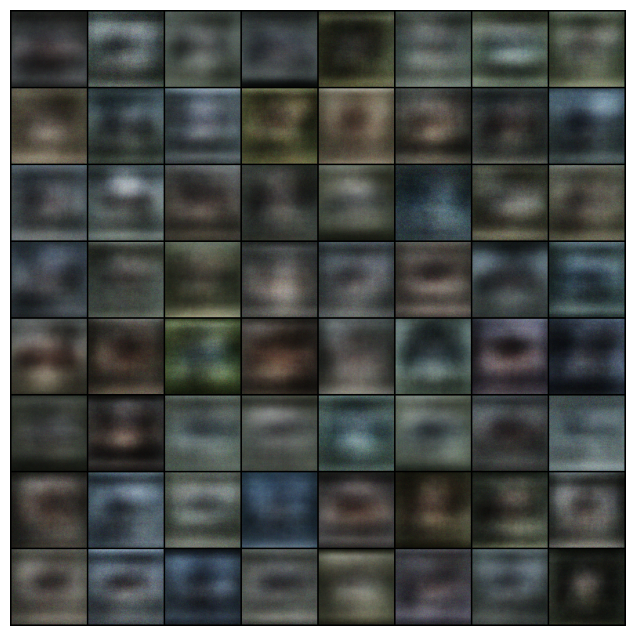

In [43]:
import matplotlib.pyplot as plt
import matplotlib.image as img
import matplotlib.animation as animation
from IPython.display import HTML

fig = plt.figure(figsize=(8, 8))
plt.axis("off")
ims = [[plt.imshow(img.imread('results_VAE/sample_' + str(epoch) + '.png'), animated=True)] for epoch in range(1, epochs + 1)]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())